#Requirements
1. Numpy
2. Pandas
3. Scipy
4. matplotlib
5. seaborn
6. sklearn
7. plotly

In [1]:
# here we will import the libraries used 
import numpy as np                                      # linear algebra
import pandas as pd                                     # data processing, CSV file I/O (e.g. pd.read_csv)
from scipy.stats import randint
import pandas as pd                                     # data processing, CSV file I/O, data manipulation 
import matplotlib.pyplot as plt                         # this is used for the plot the graph 
import seaborn as sns                                   # used for plot interactive graph. 
from pandas import set_option
plt.style.use('ggplot')                                 # nice plots

In [2]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.io as pio
pio.templates.default = "plotly_dark"

In [3]:
pio.templates.default = "ggplot2"

In [4]:
df = pd.read_csv("Credit_default_dataset.csv")

# Basic Information about dataset

In [5]:
nRow, nCol = df.shape
print(f'There are {nRow} rows and {nCol} columns')

There are 30000 rows and 25 columns


* ID: ID of each client
*LIMIT_BAL: Amount of given credit in NT dollars (includes individual and family/supplementary credit
*SEX: Gender (1=male, 2=female)
*EDUCATION: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
*MARRIAGE: Marital status (1=married, 2=single, 3=others)
*AGE: Age in years
*PAY_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, … 8=payment delay for eight months, 9=payment delay for nine months and above)
*PAY_2: Repayment status in August, 2005 (scale same as above)
*PAY_3: Repayment status in July, 2005 (scale same as above)
*PAY_4: Repayment status in June, 2005 (scale same as above)
*PAY_5: Repayment status in May, 2005 (scale same as above)
*PAY_6: Repayment status in April, 2005 (scale same as above)
*BILL_AMT1: Amount of bill statement in September, 2005 (NT dollar)
*BILL_AMT2: Amount of bill statement in August, 2005 (NT dollar)
*BILL_AMT3: Amount of bill statement in July, 2005 (NT dollar)
*BILL_AMT4: Amount of bill statement in June, 2005 (NT dollar)
*BILL_AMT5: Amount of bill statement in May, 2005 (NT dollar)
*BILL_AMT6: Amount of bill statement in April, 2005 (NT dollar)
*PAY_AMT1: Amount of previous payment in September, 2005 (NT dollar)
*PAY_AMT2: Amount of previous payment in August, 2005 (NT dollar)
*PAY_AMT3: Amount of previous payment in July, 2005 (NT dollar)
*PAY_AMT4: Amount of previous payment in June, 2005 (NT dollar)
*PAY_AMT5: Amount of previous payment in May, 2005 (NT dollar)
*PAY_AMT6: Amount of previous payment in April, 2005 (NT dollar)
*default.payment.next.month: Default payment (1=yes, 0=no)

In [6]:
pd.set_option('display.max_columns', None)
df.head(5)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,-2,-2,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,0,2,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,0,0,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,0,0,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,0,0,8617.0,5670.0,35835.0,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          30000 non-null  int64  
 1   LIMIT_BAL                   30000 non-null  float64
 2   SEX                         30000 non-null  int64  
 3   EDUCATION                   30000 non-null  int64  
 4   MARRIAGE                    30000 non-null  int64  
 5   AGE                         30000 non-null  int64  
 6   PAY_0                       30000 non-null  int64  
 7   PAY_2                       30000 non-null  int64  
 8   PAY_3                       30000 non-null  int64  
 9   PAY_4                       30000 non-null  int64  
 10  PAY_5                       30000 non-null  int64  
 11  PAY_6                       30000 non-null  int64  
 12  BILL_AMT1                   30000 non-null  float64
 13  BILL_AMT2                   300

In [8]:
#For easy Understanding changing some names
df.rename(columns={'default.payment.next.month':'defaulter'}, inplace=True)
df.rename(columns={'PAY_0':'PAY_1'}, inplace=True)

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
ID,30000.0,15000.500000,8660.398374,1.0,7500.75,15000.5,22500.25,30000.0
LIMIT_BAL,30000.0,167484.322667,129747.661567,10000.0,50000.00,140000.0,240000.00,1000000.0
SEX,30000.0,1.603733,0.489129,1.0,1.00,2.0,2.00,2.0
EDUCATION,30000.0,1.853133,0.790349,0.0,1.00,2.0,2.00,6.0
MARRIAGE,30000.0,1.551867,0.521970,0.0,1.00,2.0,2.00,3.0
AGE,30000.0,35.485500,9.217904,21.0,28.00,34.0,41.00,79.0
PAY_1,30000.0,-0.016700,1.123802,-2.0,-1.00,0.0,0.00,8.0
PAY_2,30000.0,-0.133767,1.197186,-2.0,-1.00,0.0,0.00,8.0
PAY_3,30000.0,-0.166200,1.196868,-2.0,-1.00,0.0,0.00,8.0
PAY_4,30000.0,-0.220667,1.169139,-2.0,-1.00,0.0,0.00,8.0


In [10]:
#Checking for missing values
df.isna().sum()   

ID           0
LIMIT_BAL    0
SEX          0
EDUCATION    0
MARRIAGE     0
AGE          0
PAY_1        0
PAY_2        0
PAY_3        0
PAY_4        0
PAY_5        0
PAY_6        0
BILL_AMT1    0
BILL_AMT2    0
BILL_AMT3    0
BILL_AMT4    0
BILL_AMT5    0
BILL_AMT6    0
PAY_AMT1     0
PAY_AMT2     0
PAY_AMT3     0
PAY_AMT4     0
PAY_AMT5     0
PAY_AMT6     0
defaulter    0
dtype: int64

In [11]:
# check unique values in different features
print(df.EDUCATION.unique())
print(df.MARRIAGE.unique())

[2 1 3 5 4 6 0]
[1 2 3 0]


In [12]:
fil = (df['EDUCATION'] == 5) | (df['EDUCATION'] == 6) | (df['EDUCATION'] == 0)
df.loc[fil, 'EDUCATION'] = 4
df['EDUCATION'].value_counts()

2    14030
1    10585
3     4917
4      468
Name: EDUCATION, dtype: int64

In [13]:
fil = (df['MARRIAGE'] == 0)
df.loc[fil, 'MARRIAGE'] = 3
df['MARRIAGE'].value_counts()

2    15964
1    13659
3      377
Name: MARRIAGE, dtype: int64

# Exploratory Data Analysis (EDA)

Text(0.5, 1.0, 'COUNT OF CREDIT CARDS')

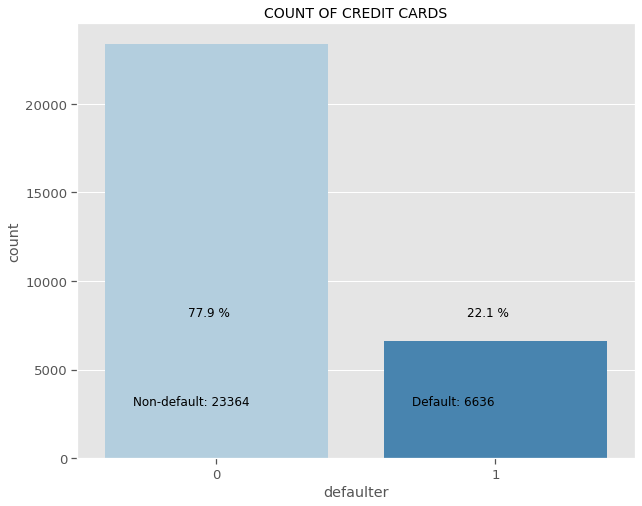

In [14]:
# The frequency of defaults
yes = df.defaulter.sum()
no = len(df)-yes

# Percentage
yes_perc = round(yes/len(df)*100, 1)
no_perc = round(no/len(df)*100, 1)


plt.figure(figsize=(10,8))
sns.set_context('notebook', font_scale=1.2)
sns.countplot('defaulter',data=df, palette="Blues")
plt.annotate('Non-default: {}'.format(no), xy=(-0.3, 15000), xytext=(-0.3, 3000), size=12)
plt.annotate('Default: {}'.format(yes), xy=(0.7, 15000), xytext=(0.7, 3000), size=12)
plt.annotate(str(no_perc)+" %", xy=(-0.3, 15000), xytext=(-0.1, 8000), size=12)
plt.annotate(str(yes_perc)+" %", xy=(0.7, 15000), xytext=(0.9, 8000), size=12)
plt.title('COUNT OF CREDIT CARDS', size=14)

We can see that the dataset consists of 77% clients are not expected to default payment whereas 23% clients are expected to default the payment.

### Categorical Features

In [15]:
def cross(Col1, Col2):
    res = pd.crosstab(df[Col1], df[Col2])
    #Calculating the percentage of defaulters
    res['Percentage'] = round((res[res.columns[1]]/(res[res.columns[0]] + res[res.columns[1]])) * 100,2)
    print(res)
    #Plotting a stack bar graph
    fig = go.Figure(data=[
    go.Bar(name='Non-Defaulters', x=res.index.to_list(),y=res[0]),
    go.Bar(name='Defaulters', x=res.index.to_list(), y=res[1],text=(res['Percentage']),textposition = "outside")])
    # Change the bar mode to stack
    fig.update_layout(barmode='stack',title_text = res.index.name + " variable v/s target" ,xaxis_title=res.index.name,yaxis_title="Number of count")
    fig.show()

1. SEX

In [16]:
cross("SEX","defaulter")
#1 => Male
#2 => Female

defaulter      0     1  Percentage
SEX                               
1           9015  2873       24.17
2          14349  3763       20.78


Comments: Percenatage of defaulters is more in male then female. Also female client is also high in number

2. EDUCATION

In [17]:
cross("EDUCATION","defaulter")

defaulter      0     1  Percentage
EDUCATION                         
1           8549  2036       19.23
2          10700  3330       23.73
3           3680  1237       25.16
4            435    33        7.05


Comments: Most defaulters have education level of university followed by graduate school

3. MARRIAGE

In [18]:
cross("MARRIAGE","defaulter")

defaulter      0     1  Percentage
MARRIAGE                          
1          10453  3206       23.47
2          12623  3341       20.93
3            288    89       23.61


Comments: Most of the clients are either marrined or single (less frequent the other status).

### Numerical features

1. AGE And LIMIT_BAL

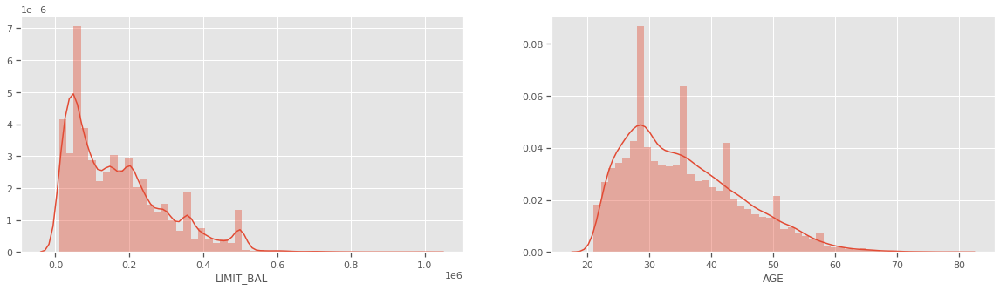

In [32]:
plt.subplots(figsize=(20,5))
plt.subplot(121)
sns.distplot(df.LIMIT_BAL)

plt.subplot(122)
sns.distplot(df.AGE)

plt.show()

By plotting the continous variables we observe that dataset consists of skewed data of limiting balance and age of clients.
We have more number of clients having limiting balance between 0 to 200000 currency.
We have more number of clients from age bracket of 20 to 40, i.e., clients from mostly young to mid aged groups.

In [20]:
fig = go.Figure()
fig.add_trace(go.Histogram(x = df[df['defaulter'] == 0]["AGE"],marker_color="green",name="Non-defaulters"))
fig.add_trace(go.Histogram(x = df[df['defaulter'] == 1]["AGE"],marker_color="orange",name="Defaulters"))
# Overlay both histograms
fig.update_layout(barmode='overlay')
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.update_layout(title="Distribution of age of defaulters and non-defaulters",xaxis_title="AGE",yaxis_title="Counts")
fig.show()

The distribution is almost uniformly distributed but a bit right skewed for the defaulters. But it shows that old age people are almost non-defaulters

<ipython-input-33-b106904ccfa8>:12: MatplotlibDeprecationWarning:

Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later



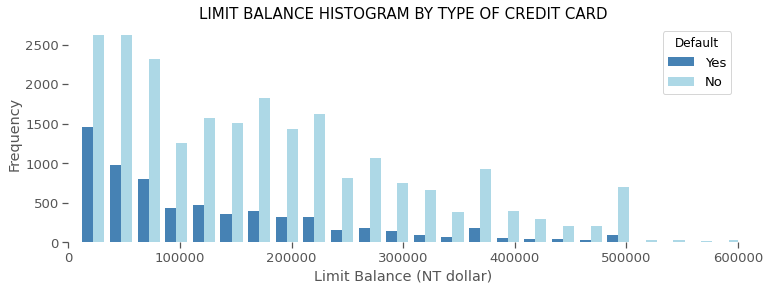

In [33]:
x1 = list(df[df['defaulter'] == 1]['LIMIT_BAL'])
x2 = list(df[df['defaulter'] == 0]['LIMIT_BAL'])

plt.figure(figsize=(12,4))
sns.set_context('notebook', font_scale=1.2)
#sns.set_color_codes("pastel")
plt.hist([x1, x2], bins = 40, color=['steelblue', 'lightblue'])
plt.xlim([0,600000])
plt.legend(['Yes', 'No'], title = 'Default', loc='upper right', facecolor='white')
plt.xlabel('Limit Balance (NT dollar)')
plt.ylabel('Frequency')
plt.title('LIMIT BALANCE HISTOGRAM BY TYPE OF CREDIT CARD', SIZE=15)
plt.box(False)
#plt.savefig('ImageName', format='png', dpi=200, transparent=True);

Comments: Clients having lower Balance have more chances of default then higher Balance

2. Amount of bill statement in different months

In [22]:
bills = df[['BILL_AMT1','BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6']]

In [23]:
fig =  make_subplots(rows= 3, cols=2,subplot_titles=bills.columns.to_list())  

fig.add_trace(go.Histogram(x= df["BILL_AMT1"],name='BILL_AMT1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT2"],name='BILL_AMT2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["BILL_AMT3"],name='BILL_AMT3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT4"],name='BILL_AMT4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["BILL_AMT5"],name='BILL_AMT5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["BILL_AMT6"],name='BILL_AMT6'),row = 3, col = 2)


fig.update_layout(height=600, width=800, title_text="Histogram Subplots of Bill Amount")
fig.show()

3. Amount of previous payments in  different months

In [24]:
pay = df[['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']]
fig = make_subplots(rows= 3, cols=2,subplot_titles=pay.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_AMT1"],name='PAY_AMT1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT2"],name='PAY_AMT2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_AMT3"],name='PAY_AMT3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT4"],name='PAY_AMT4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_AMT5"],name='PAY_AMT5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_AMT6"],name='PAY_AMT6'),row = 3, col = 2)


fig.update_layout(height=600, width=800, title_text="Histogram Subplots of Amount of Previous Payment")
fig.show()

Highely Skewed Data, we need tranformations during training

4. Repayment status in different months

In [25]:
pay_s = df[['PAY_1','PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']]
df['PAY_1'].value_counts().index.to_list().sort()
fig = make_subplots(rows= 3, cols=2,subplot_titles=pay_s.columns.to_list())  

fig.add_trace(go.Histogram(x= df["PAY_1"],name='PAY_1'),row = 1, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_2"],name='PAY_2'),row = 2, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_3"],name='PAY_3'),row = 3, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_4"],name='PAY_4'),row = 1, col = 2)
fig.add_trace(go.Histogram(x= df["PAY_5"],name='PAY_5'),row = 2, col = 1)
fig.add_trace(go.Histogram(x= df["PAY_6"],name='PAY_6'),row = 3, col = 2)


fig.update_layout(bargap=0.2,height=600, width=800, title_text="Histogram Subplots of Previous Payment Status")
fig.show()

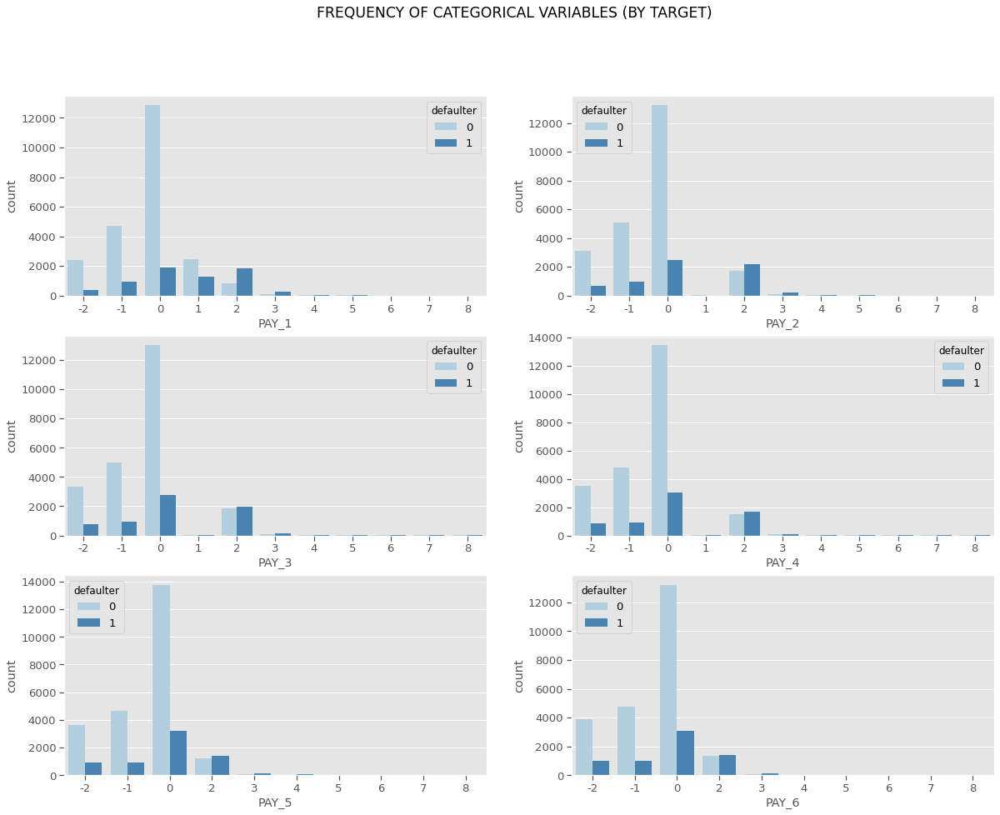

In [26]:
subset = df[[ 'PAY_1', 'PAY_2', 'PAY_3', 'PAY_4', 
               'PAY_5', 'PAY_6', 'defaulter']]

f, axes = plt.subplots(3, 2, figsize=(20, 15), facecolor='white')
f.suptitle('FREQUENCY OF CATEGORICAL VARIABLES (BY TARGET)')
ax1 = sns.countplot(x="PAY_1", hue="defaulter", data=subset, palette="Blues",ax=axes[0,0])
ax2 = sns.countplot(x="PAY_2", hue="defaulter", data=subset, palette="Blues",ax=axes[0,1])
ax3 = sns.countplot(x="PAY_3", hue="defaulter", data=subset, palette="Blues",ax=axes[1,0])
ax4 = sns.countplot(x="PAY_4", hue="defaulter", data=subset, palette="Blues",ax=axes[1,1])
ax5 = sns.countplot(x="PAY_5", hue="defaulter", data=subset, palette="Blues",ax=axes[2,0])
ax6 = sns.countplot(x="PAY_6", hue="defaulter", data=subset, palette="Blues",ax=axes[2,1]);

Comments: Above plot shows us the proportion of clients that will default payment next month based on repayment history.
For Current month status, the earlier the payment is made lesser are the chances of those clients defaulting the payment.

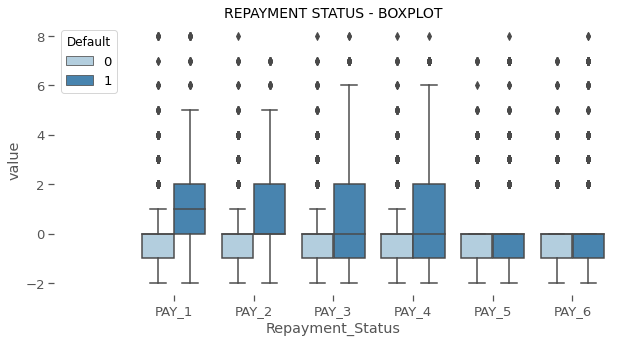

In [27]:
Repayment = df[['PAY_1', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6']]

Repayment = pd.concat([df.defaulter,Repayment],axis=1)
Repayment = pd.melt(Repayment,id_vars="defaulter",
                    var_name="Repayment_Status",
                    value_name='value')

plt.figure(figsize=(10,5))
sns.set_context('notebook', font_scale=1.2)
sns.boxplot(y="value", x="Repayment_Status", hue="defaulter", data=Repayment, palette='Blues')
plt.legend(loc='best', title= 'Default', facecolor='white')
plt.xlim([-1.5,5.5])
plt.title('REPAYMENT STATUS - BOXPLOT', size=14)
plt.box(False)
plt.savefig('ImageName', format='png', dpi=200);

It seems that PAY_1 (Repayment status in September) and PAY_2 (Repayment status in August) have more discriminatory power the repayment status in other months.

## Standardizing and plotting the data

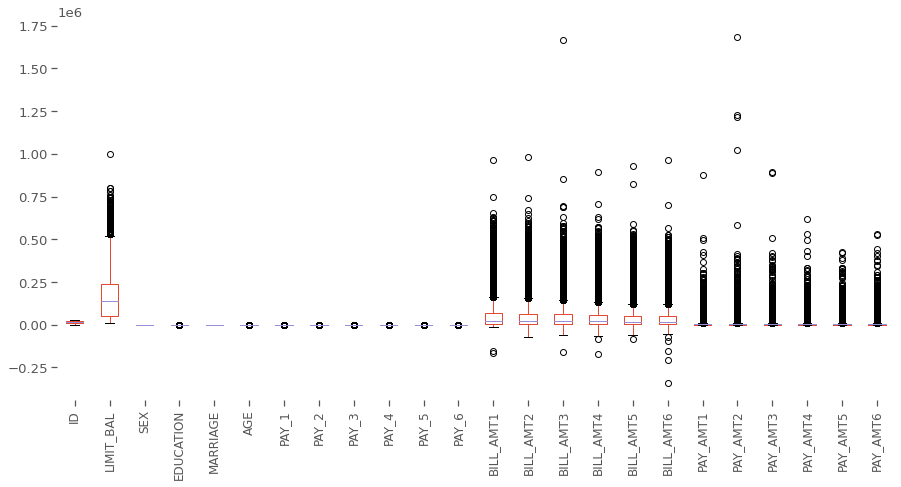

In [28]:
plt.figure(figsize=(15,7))
ax= df.drop('defaulter', axis=1).boxplot(df.columns.name, rot=90)
outliers = dict(markerfacecolor='b', marker='p')
plt.xticks(size=12)
plt.box(False);

The above boxplot reveals that features are in different scales and units. Many models use some form of distance when making predictions, and therefore, it is recommended to normalize the data.

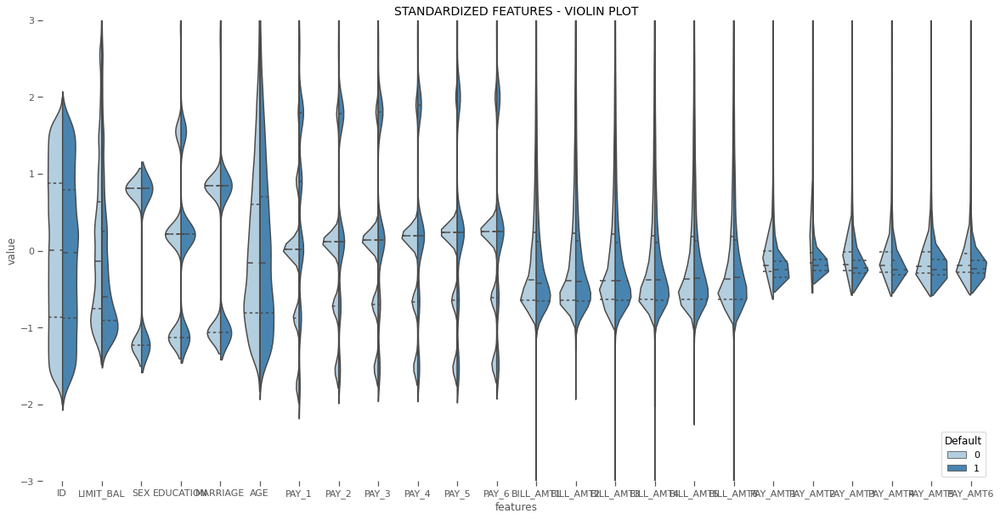

In [29]:
features = df.drop('defaulter', axis = 1, inplace = False)
stdX = (features - features.mean()) / (features.std())              # standardization
data_st = pd.concat([df.defaulter,stdX.iloc[:,:]],axis=1)
data_st = pd.melt(data_st,id_vars="defaulter",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(20,10))
sns.set_context('notebook', font_scale=1)
sns.violinplot(y="value", x="features", hue="defaulter", data=data_st,split=True, 
               inner="quart", palette='Blues')
plt.legend(loc=4, title= 'Default', facecolor='white')
plt.ylim([-3,3])
plt.title('STANDARDIZED FEATURES - VIOLIN PLOT', size=14)
plt.box(False)
plt.savefig('ImageName', format='png', dpi=200, transparent=False);

Above Standardization of data was performed; i.e, all features are centered around zero and have variance one. Features were plotted again, using a violin plot.

## Correlation

A correlation matrix of all variables is shown in the heatmap below. The only feature with a notable positive correlation with the dependent variable ‘defaulter’ is re-payment status during the last month (September). The highest negative correlation with default occurs with Limit_Balance, indicating that customers with lower limit balance are more likely to default. It can also be observed that some variables are highly correlated to each other, that is the case of the amount of bill statement and the repayment status in different months.

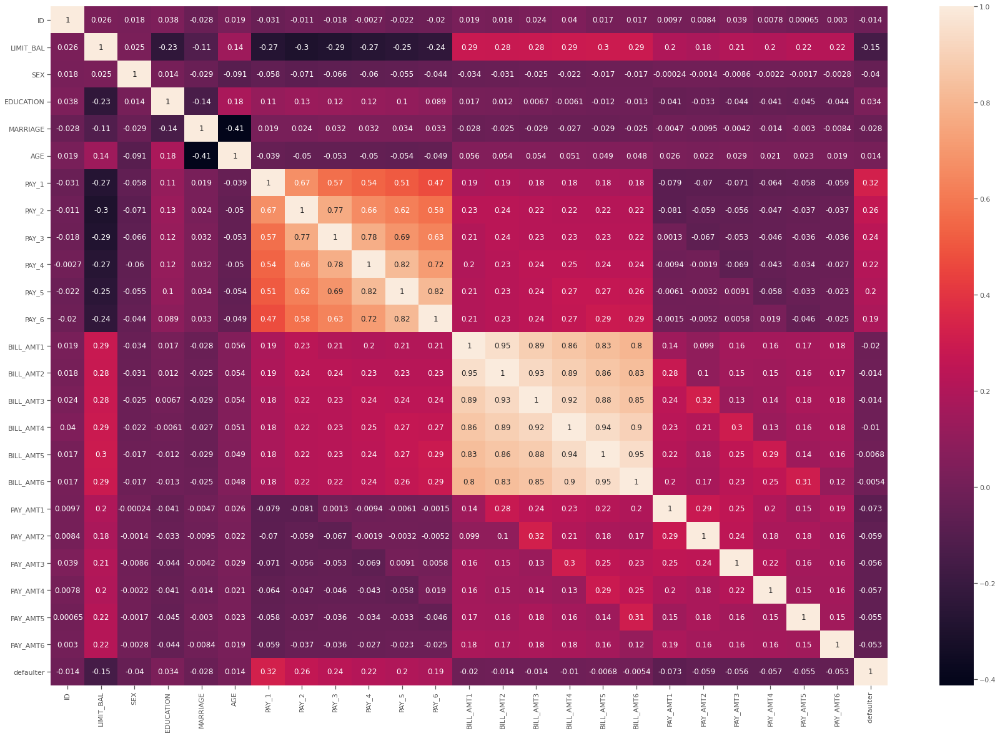

In [30]:
plt.subplots(figsize=(30,20))
sns.heatmap(df.corr(), annot=True)
plt.show()

## Some Usefull insight using more than one feature in combination:

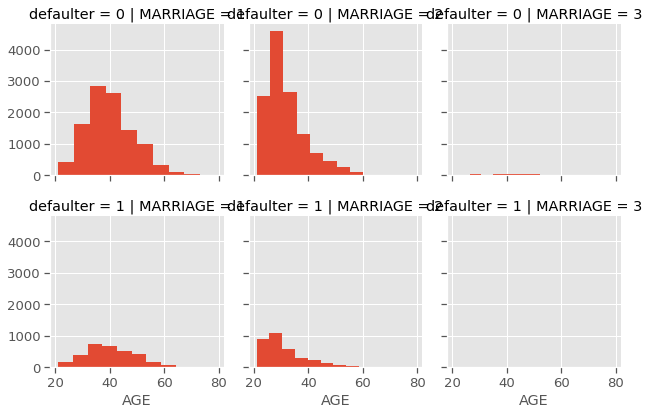

In [44]:
g = sns.FacetGrid(df, row='defaulter', col='MARRIAGE')
g = g.map(plt.hist, 'AGE')
plt.show()

Comments: From above plot we can infer that married people between age bracket of 30 and 50 and unmarried clients of age 20-30 tend to default payment with unmarried clients higher probability to default payment. Hence we can include MARRIAGE feature of clients to find probability of defaulting the payment next month

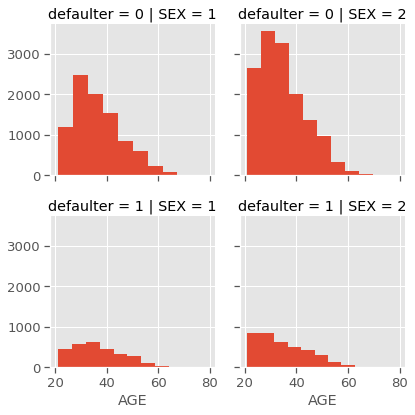

In [39]:
g = sns.FacetGrid(df, row='defaulter', col='SEX')
g = g.map(plt.hist, 'AGE')

Comments: It can be seen that females of age group 20-30 have very high tendency to default payment compared to males in all age brackets. Hence we can keep the SEX column of clients to predict probability of defaulting payment.

In [48]:
def get_group (age):
        if age < 40:
            return "Young"
        elif age >= 60:
            return "Old"
        else:
            return "Middle"

In [51]:
# apply to "AGE" and create a new column
df["Age_group"] = df["AGE"].apply(get_group)

Grouped age and education background vs Default Rate


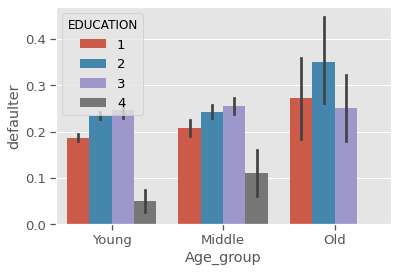

In [56]:
print("Grouped age and education background vs Default Rate")

sns.barplot(x = 'Age_group', y = "defaulter", data = df, hue = "EDUCATION")
plt.show()

Commnets: the default rate of customer having High School Education background is very close across all age agroup
The default rate of customer having University and Graduate School Education background is high for Old Age >Group, and reletively low for Young and Middle age group

<Figure size 1296x1296 with 0 Axes>

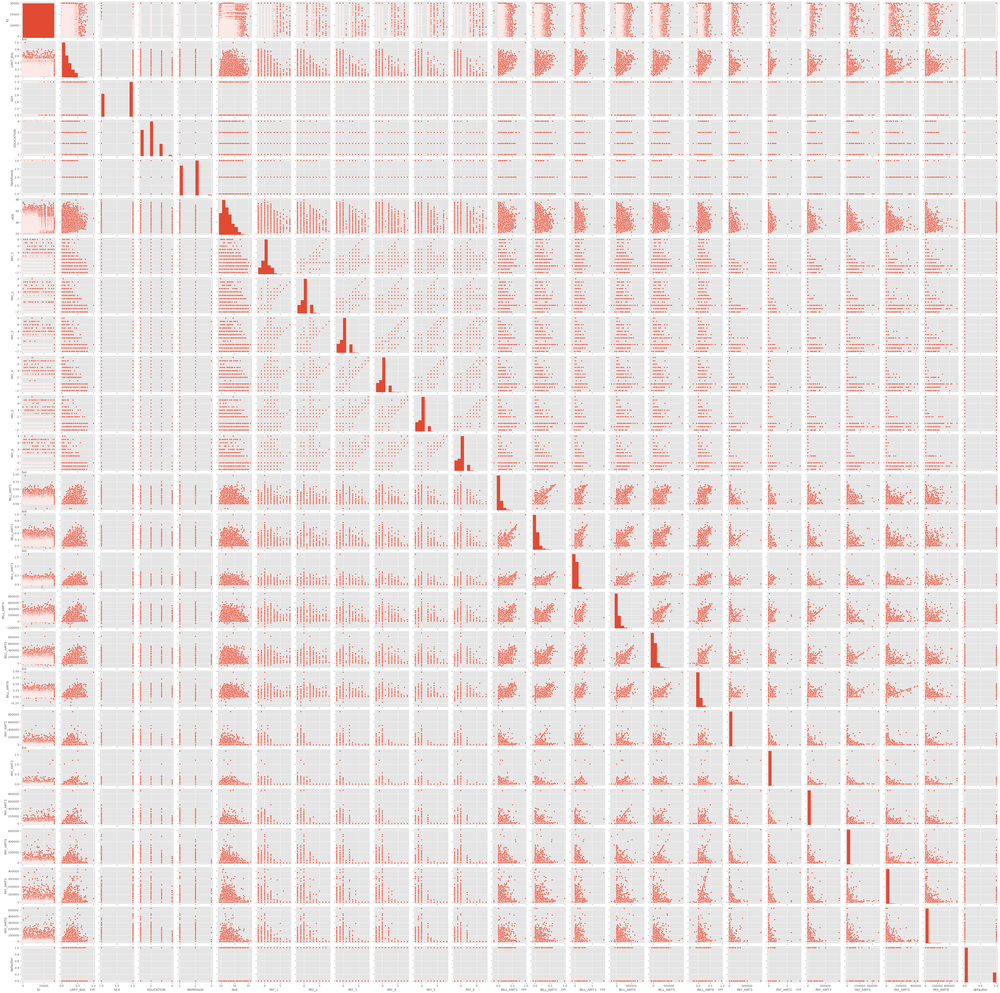

In [57]:
plt.figure(figsize=(18,18))
sns.pairplot(df)
plt.show()